In [1]:
# default_exp ais_clustering
%load_ext autoreload
%autoreload 2

# AIS Velocity Clustering
> Can we detect convoys?

## Pre-req
This notebook is meant to be run with `ais-analytic/scripts/jupyter_notebook.sh` to set up your Spark env.


## Approach
Say some more here. For example:
* Kinds of ships/trips
* Fleet detection
* Trips/journeys

In [2]:
# export
import pyspark.sql.functions as F

import math

import numpy as np
import pandas as pd
from geopy import distance

from datetime import datetime

import plotly.express as px
# import matplotlib.pyplot as plt
# %matplotlib inline

import hdbscan

In [3]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [24]:
# export
ais = spark.table('af_vault.ais')

def clean_ais(ais):
    """Remove bad rows from AIS table, and print row counts"""
    c0 = ais.count()
    print(f'{c0:,} initial rows')
    # Remove header rows, if present
    ais = ais.filter(ais['basedatetime']!='BaseDateTime') 
    c1 = ais.count()
    print(f'{c1:,} rows after removing BaseDateTime')
    ais = ais.filter((ais['vesselname']!='') | (ais['imo']!='') | (ais['mmsi']!=''))
    c2 = ais.count()
    print(f'{c2:,} rows after removing blank vesselname, imo, mmsi')
    print('-'*len(f'{c2:,}'))
    print(f'{c0 - c2:,} rows removed')
    ais.cache()
    return ais

ais = clean_ais(ais)

9,088,564 initial rows
9,088,555 rows after removing BaseDateTime
9,088,555 rows after removing blank vesselname, imo, mmsi
---------
9 rows removed


Explode the datetime field into meaningful columns.

Old code:
```python
ais = ais.withColumn('year', ais['basedatetime'].substr(1,4))
ais = ais.withColumn('month', ais['basedatetime'].substr(6,2))
ais = ais.withColumn('day', ais['basedatetime'].substr(9,2))
ais = ais.withColumn('hour', ais['basedatetime'].substr(12,2))
ais = ais.withColumn('min', ais['basedatetime'].substr(15,2))
ais = ais.withColumn('sec', ais['basedatetime'].substr(18,2))
```

In [25]:
# export
def explode_dates(ais, keep_dt=False):
    """Explode basedatetime into useful fields. If `keep_dt==False`, drop basedatetime."""
    bdt = ais['basedatetime']
    ais = ais.withColumn('year', F.year(bdt)) \
            .withColumn('month', F.month(bdt).cast('tinyint')) \
            .withColumn('day', F.dayofmonth(bdt).cast('tinyint')) \
            .withColumn('hour', F.hour(bdt).cast('tinyint')) \
            .withColumn('min', F.minute(bdt).cast('tinyint')) \
            .withColumn('sec', F.second(bdt).cast('tinyint'))
    if keep_dt:
        return ais
    return ais.drop('basedatetime')

ais = explode_dates(ais, keep_dt=True)

In [26]:
ais.dtypes

[('mmsi', 'string'),
 ('basedatetime', 'string'),
 ('lat', 'float'),
 ('lon', 'float'),
 ('sog', 'float'),
 ('cog', 'float'),
 ('heading', 'float'),
 ('vesselname', 'string'),
 ('imo', 'string'),
 ('callsign', 'string'),
 ('vesseltype', 'string'),
 ('status', 'string'),
 ('length', 'float'),
 ('width', 'float'),
 ('draft', 'float'),
 ('cargo', 'int'),
 ('year', 'int'),
 ('month', 'tinyint'),
 ('day', 'tinyint'),
 ('hour', 'tinyint'),
 ('min', 'tinyint'),
 ('sec', 'tinyint')]

## Pick one day for Pandas Exploration

In [27]:
# export
sdf = ais.filter((ais['year']=='2015') & (ais['month']=='01') & (ais['day']=='01'))
pdf = sdf.toPandas()

In [28]:
#export
df = pdf.copy(deep=True)
df.shape

(81434, 22)

In [29]:
#export
entity = ['imo', 'vesselname', 'mmsi']

Create LatLon pairs for previous/curr position. 

In [30]:
# export
# Let's drop columns we don't need to reduce memory
# df = df[['imo', 'basedatetime', 'lat', 'lon']]

# We want things to be time ordered within each IMO. Sorting by IMO shouldn't technically matter,
# but it will make the index behave better and make checking things easier
df = df.sort_values(['imo','basedatetime'])

# Let's get the index in our new order
df = df.reset_index(drop=True)

# Create the lat-lon pairs the distance function needs
df['latlon'] = list(zip(df['lat'], df['lon']))

# Create columns for lat-lon and datetime that are shifted forward by 1, within each IMO. This means there
# will be a NaN at the first time point for each IMO
df['latlon_previous'] = df.groupby(entity).latlon.shift(1)
df['basedatetime_previous'] = df.groupby(entity)['basedatetime'].shift(1)

# Eliminate the rows without a pair (i.e the row of the first timestamp)
df = df[~df['latlon_previous'].isnull()].copy(deep=True)

# Create column with the pairings for lat-lon and datetime
df['latlon_pair'] = list(zip(df['latlon_previous'], df['latlon']))
df['datetime_pair'] = list(zip(df['basedatetime_previous'], df['basedatetime']))

Calculate distances

In [35]:
#export
def calculate_distance(latlonpair):
    return distance.distance(latlonpair[0], latlonpair[1]).km

def calculate_time_delta(timeseq):
    t0 = datetime.fromisoformat(timeseq[0])
    t1 = datetime.fromisoformat(timeseq[1])
    delta_hrs = (t1 - t0).total_seconds() / 3600
    return delta_hrs    

df['distance_km'] = df['latlon_pair'].map(calculate_distance)
df['time_hrs'] = df['datetime_pair'].map(calculate_time_delta)
df['velocity'] = df['distance_km'] / df['time_hrs']

In [36]:
df.head()

,mmsi,basedatetime,lat,lon,sog,cog,heading,vesselname,imo,callsign,...,min,sec,latlon,latlon_previous,basedatetime_previous,latlon_pair,datetime_pair,distance_km,time_hrs,velocity
9,367008590,2015-01-01T00:01:12,53.907108,-166.510086,0.0,129.399994,511.0,FARRAR SEA,,WAW4840,...,1,12,"(53.907108306884766, -166.5100860595703)","(53.907108306884766, -166.5100860595703)",2015-01-01T00:00:02,"((53.907108306884766, -166.5100860595703), (53...","(2015-01-01T00:00:02, 2015-01-01T00:01:12)",0.000000,0.019444,0.000000
10,433867110,2015-01-01T00:01:13,53.905281,-166.511673,0.0,-79.699997,511.0,STORM.PETREL,,WCZ6533,...,1,13,"(53.90528106689453, -166.5116729736328)","(53.905269622802734, -166.5116729736328)",2015-01-01T00:00:04,"((53.905269622802734, -166.5116729736328), (53...","(2015-01-01T00:00:04, 2015-01-01T00:01:13)",0.001274,0.019167,0.066457
11,368564000,2015-01-01T00:01:15,53.879471,-166.541000,0.0,171.899994,511.0,JUSTINE,,WDF6361,...,1,15,"(53.87947082519531, -166.54100036621094)","(53.879451751708984, -166.541015625)",2015-01-01T00:00:05,"((53.879451751708984, -166.541015625), (53.879...","(2015-01-01T00:00:05, 2015-01-01T00:01:15)",0.002348,0.019444,0.120762
12,367497340,2015-01-01T00:01:26,55.059361,-162.327560,0.1,-118.900002,207.0,MISS COURTNEY KIM,,WDF8673,...,1,26,"(55.05936050415039, -162.3275604248047)","(55.05936050415039, -162.3275604248047)",2015-01-01T00:00:06,"((55.05936050415039, -162.3275604248047), (55....","(2015-01-01T00:00:06, 2015-01-01T00:01:26)",0.000000,0.022222,0.000000
14,338945000,2015-01-01T00:02:11,55.216431,-163.461517,9.6,50.500000,511.0,CG ALEX HALEY,,NZPO,...,2,11,"(55.2164306640625, -163.46151733398438)","(55.21308898925781, -163.46876525878906)",2015-01-01T00:00:10,"((55.21308898925781, -163.46876525878906), (55...","(2015-01-01T00:00:10, 2015-01-01T00:02:11)",0.592653,0.033611,17.632644


<IPython.core.display.Javascript object>


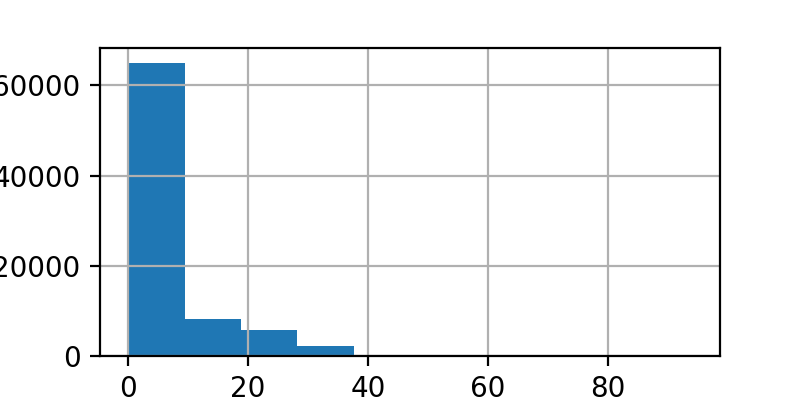

<AxesSubplot:>

In [40]:
%matplotlib notebook
df.velocity.hist(figsize=(4,2))

In [41]:
# export
# LICENSE: public domain
# https://gist.github.com/jeromer/2005586

def calculate_initial_compass_bearing(pointA, pointB):
    """
    Calculates the bearing between two points.
    The formulae used is the following:
        θ = atan2(sin(Δlong).cos(lat2),
                  cos(lat1).sin(lat2) − sin(lat1).cos(lat2).cos(Δlong))
    :Parameters:
      - `pointA: The tuple representing the latitude/longitude for the
        first point. Latitude and longitude must be in decimal degrees
      - `pointB: The tuple representing the latitude/longitude for the
        second point. Latitude and longitude must be in decimal degrees
    :Returns:
      The bearing in degrees
    :Returns Type:
      float
    """
    if (type(pointA) != tuple) or (type(pointB) != tuple):
        raise TypeError("Only tuples are supported as arguments")

    lat1 = math.radians(pointA[0])
    lat2 = math.radians(pointB[0])

    diffLong = math.radians(pointB[1] - pointA[1])

    x = math.sin(diffLong) * math.cos(lat2)
    y = math.cos(lat1) * math.sin(lat2) - (math.sin(lat1)
            * math.cos(lat2) * math.cos(diffLong))

    initial_bearing = math.atan2(x, y)

    # Now we have the initial bearing but math.atan2 return values
    # from -180° to + 180° which is not what we want for a compass bearing
    # The solution is to normalize the initial bearing as shown below
    initial_bearing = math.degrees(initial_bearing)
    compass_bearing = (initial_bearing + 360) % 360

    return compass_bearing

In [42]:
#export
df['bearing'] = df['latlon_pair'].map(lambda x: calculate_initial_compass_bearing(*x))

In [43]:
#export
df.head()

,mmsi,basedatetime,lat,lon,sog,cog,heading,vesselname,imo,callsign,...,sec,latlon,latlon_previous,basedatetime_previous,latlon_pair,datetime_pair,distance_km,time_hrs,velocity,bearing
9,367008590,2015-01-01T00:01:12,53.907108,-166.510086,0.0,129.399994,511.0,FARRAR SEA,,WAW4840,...,12,"(53.907108306884766, -166.5100860595703)","(53.907108306884766, -166.5100860595703)",2015-01-01T00:00:02,"((53.907108306884766, -166.5100860595703), (53...","(2015-01-01T00:00:02, 2015-01-01T00:01:12)",0.000000,0.019444,0.000000,0.000000
10,433867110,2015-01-01T00:01:13,53.905281,-166.511673,0.0,-79.699997,511.0,STORM.PETREL,,WCZ6533,...,13,"(53.90528106689453, -166.5116729736328)","(53.905269622802734, -166.5116729736328)",2015-01-01T00:00:04,"((53.905269622802734, -166.5116729736328), (53...","(2015-01-01T00:00:04, 2015-01-01T00:01:13)",0.001274,0.019167,0.066457,0.000000
11,368564000,2015-01-01T00:01:15,53.879471,-166.541000,0.0,171.899994,511.0,JUSTINE,,WDF6361,...,15,"(53.87947082519531, -166.54100036621094)","(53.879451751708984, -166.541015625)",2015-01-01T00:00:05,"((53.879451751708984, -166.541015625), (53.879...","(2015-01-01T00:00:05, 2015-01-01T00:01:15)",0.002348,0.019444,0.120762,25.248032
12,367497340,2015-01-01T00:01:26,55.059361,-162.327560,0.1,-118.900002,207.0,MISS COURTNEY KIM,,WDF8673,...,26,"(55.05936050415039, -162.3275604248047)","(55.05936050415039, -162.3275604248047)",2015-01-01T00:00:06,"((55.05936050415039, -162.3275604248047), (55....","(2015-01-01T00:00:06, 2015-01-01T00:01:26)",0.000000,0.022222,0.000000,0.000000
14,338945000,2015-01-01T00:02:11,55.216431,-163.461517,9.6,50.500000,511.0,CG ALEX HALEY,,NZPO,...,11,"(55.2164306640625, -163.46151733398438)","(55.21308898925781, -163.46876525878906)",2015-01-01T00:00:10,"((55.21308898925781, -163.46876525878906), (55...","(2015-01-01T00:00:10, 2015-01-01T00:02:11)",0.592653,0.033611,17.632644,51.053526


In [56]:
#export
fig = px.scatter_polar(df, r="velocity", theta="bearing", title="Bearing x Velocity")
fig.update_traces(opacity=.3, marker_size=3)
fig.show()

In [54]:
#export 
fig = px.scatter(df, x='heading', y='bearing', color='velocity', title='Heading vs Bearing')
fig.update_traces(opacity=.1, marker_size=2)
fig.show()

In [55]:
fig = px.scatter(df, x='cog', y='bearing', color='velocity', title='COG vs Bearing')
fig.update_traces(opacity=.1, marker_size=2)
fig.show()

COG has an extraction artifact probably caused by endian-ness mismatch in hexadecimal.  We can fix it by adding ~410 to the negatives. 

In [75]:
shear, right = df.cog.max(), df.cog[df.cog<0].max()
delta = 360 - right
print(shear, right, delta)

204.7 -49.6 409.5999984741211


In [76]:
def rectify(x):
    if x >= 0:
        return x
    return x + delta
df['cog2'] = df['cog'].map(rectify)
df.cog2.describe()

count    81318.000000
mean       210.790280
std        107.716008
min          0.000000
25%        128.000000
50%        243.700005
75%        299.599998
max        360.000000
Name: cog2, dtype: float64

In [77]:
fig = px.scatter(df, x='cog2', y='bearing', color='velocity', title='Repaired COG vs Bearing', render_mode='webgl')
fig.update_traces(opacity=.1, marker_size=2)
fig.show()

In [78]:
fig = px.scatter(df[df.velocity > 1], x='cog2', y='bearing', color='velocity', title='Repaired COG vs Bearing | Velocity > 1', render_mode='webgl')
fig.update_traces(opacity=.1, marker_size=2)
fig.show()

### Aggregate by hour

In [78]:
dfg = df.groupby(['vesselname','imo','mmsi','hour'])[['lat','lon','bearing']].agg({'lat': np.mean, 'lon': np.mean, 'bearing': np.mean})
dfg = dfg.reset_index()

hdb = hdbscan.HDBSCAN()
hdb.fit(dfg[['lat','lon','bearing']])

print(np.unique(hdb.labels_).shape)

dfg['cluster'] = ['c' + str(x) for x in hdb.labels_]

cluster_size = dfg['cluster'].value_counts().rename_axis('cluster').reset_index(name='cluster_size')

dfg.shape

dfg = pd.merge(dfg, cluster_size, on='cluster')

dfg.shape

(105,)


(1963, 9)

In [79]:
px.histogram(dfg['cluster_size'], nbins=300)

In [67]:
dfg_center = {'lat': dfg['lat'].mean(), 'lon': dfg['lon'].mean()}

In [69]:
dfg_center

{'lat': 54.154205, 'lon': -166.39937}

In [74]:
fig = px.scatter_geo(dfg[dfg['cluster_size']>5], 
                     lat='lat', 
                     lon='lon', 
                     color='cluster', 
                     hover_name='hour', 
                     hover_data=['vesselname'],
                     color_discrete_sequence=px.colors.qualitative.Dark24_r)

fig.show()

In [77]:
fig = px.scatter_geo(dfg[(dfg['cluster_size']>10) & (dfg['cluster']!='c-1')], 
                     lat='lat', 
                     lon='lon', 
                     color='cluster', 
                     hover_name='hour', 
                     hover_data=['vesselname'],
                     color_discrete_sequence=px.colors.qualitative.Dark24_r)

fig.show()

### Cluster with velocities included

In [151]:
dfg = df.groupby(['vesselname','imo','mmsi','hour'])[['lat','lon','bearing','velocity']].agg({'lat': np.mean, 'lon': np.mean, 'bearing': np.mean, 'velocity': np.mean})

dfg = dfg.reset_index()

hdb = hdbscan.HDBSCAN()
hdb.fit(dfg[['lat','lon','bearing', 'velocity']])

print(np.unique(hdb.labels_).shape)

dfg['cluster'] = ['c' + str(x) for x in hdb.labels_]
dfg['cluster_number'] = hdb.labels_

cluster_size = dfg['cluster'].value_counts().rename_axis('cluster').reset_index(name='cluster_size')

dfg.shape

dfg = pd.merge(dfg, cluster_size, on='cluster')

dfg = dfg.sort_values('cluster_size', ascending=False)
dfg.shape

dfg.head()

(104,)


,vesselname,imo,mmsi,hour,lat,lon,bearing,velocity,cluster,cluster_number,cluster_size
344,PATRICIA LEE,IMO7809455,368526000,22,57.163109,-171.084595,277.760073,0.251877,c-1,-1,440
285,KUSTATAN,IMO8856510,367011410,22,53.891861,-166.534576,149.746755,0.002047,c-1,-1,440
311,NORDIC MARINER,IMO7742580,368608000,08,53.883465,-166.530777,118.101784,0.001170,c-1,-1,440
310,NORDIC MARINER,IMO7742580,368608000,04,53.883472,-166.530777,134.557707,0.001843,c-1,-1,440
309,NO1 POHAH,IMO8714944,371542000,06,53.858540,-166.576080,179.398811,0.006670,c-1,-1,440


In [156]:
dfg[(dfg['vesselname']=='PATRICIA LEE') | (dfg['vesselname']=='ALASKA SPIRIT')].groupby(['imo', 'vesselname', 'mmsi']).count()

,,,hour,lat,lon,bearing,velocity,cluster,cluster_number,cluster_size
imo,vesselname,mmsi,,,,,,,,
IMO7809455,PATRICIA LEE,368526000,7,7,7,7,7,7,7,7
IMO7933622,ALASKA SPIRIT,366542920,6,6,6,6,6,6,6,6


In [157]:
dfg[(dfg['vesselname']=='GULF VALOUR') | (dfg['vesselname']=='POLE')].groupby(['imo', 'vesselname', 'mmsi']).count()

,,,hour,lat,lon,bearing,velocity,cluster,cluster_number,cluster_size
imo,vesselname,mmsi,,,,,,,,
IMO9128245,POLE,247119100,16,16,16,16,16,16,16,16
IMO9505821,GULF VALOUR,311072100,12,12,12,12,12,12,12,12


In [153]:
fig = px.scatter_geo(dfg,#[dfg['cluster_size']>5], 
                     lat='lat', 
                     lon='lon', 
                     color='cluster', 
                     hover_name='hour', 
                     hover_data=['vesselname'],
                     color_discrete_sequence=px.colors.qualitative.Dark24_r)

fig.show()

In [122]:
fig = px.scatter_geo(dfg.sort_values('cluster_size', ascending=False), 
                     lat='lat', 
                     lon='lon', 
                     color='cluster', 
                     hover_name='hour', 
                     hover_data=['vesselname','cluster_size'],
                     color_discrete_sequence=px.colors.qualitative.Dark24, animation_frame="cluster")
fig.show()

### Now let's alter some hdbscan parameters

In [132]:
dfg = df.groupby(['vesselname','imo','mmsi','hour'])[['lat','lon','bearing','velocity']].agg({'lat': np.mean, 'lon': np.mean, 'bearing': np.mean, 'velocity': np.mean})

dfg = dfg.reset_index()

hdb = hdbscan.HDBSCAN(min_cluster_size=10)
hdb.fit(dfg[['lat','lon','bearing']])

print(np.unique(hdb.labels_).shape)

dfg['cluster'] = ['c' + str(x) for x in hdb.labels_]
dfg['cluster_number'] = hdb.labels_

cluster_size = dfg['cluster'].value_counts().rename_axis('cluster').reset_index(name='cluster_size')
dfg = pd.merge(dfg, cluster_size, on='cluster')
dfg = dfg.sort_values('cluster_size', ascending=False)

(77,)


In [133]:
fig = px.scatter_geo(dfg,#[dfg['cluster_size']>5], 
                     lat='lat', 
                     lon='lon', 
                     color='cluster', 
                     hover_name='hour', 
                     hover_data=['vesselname'],
                     color_discrete_sequence=px.colors.qualitative.Dark24_r)

fig.show()

### Add time dependence

In [137]:
df['hour'].value_counts().sort_index()

00    3369
01    3612
02    3587
03    3705
04    3663
05    3648
06    3581
07    3473
08    3272
09    3409
10    3431
11    3331
12    3254
13    3272
14    3238
15    3243
16    3169
17    3248
18    3346
19    3407
20    3359
21    3312
22    3233
23    3156
Name: hour, dtype: int64

In [146]:
timeblock = 6
current_df = df.copy(deep=True)
current_df['timeblock'] = current_df['hour'].map(lambda x: np.floor(float(x) / timeblock).astype(np.int32))

In [149]:
current_timeblock = 0
dfg = current_df[current_df['timeblock']==current_timeblock].groupby(['vesselname','imo','mmsi','hour'])[['lat','lon','bearing','velocity']]\
                 .agg({'lat': np.mean, 'lon': np.mean, 'bearing': np.mean, 'velocity': np.mean})

dfg = dfg.reset_index()

hdb = hdbscan.HDBSCAN()
hdb.fit(dfg[['lat','lon','bearing']])

print(np.unique(hdb.labels_).shape)

dfg['cluster'] = ['c' + str(x) for x in hdb.labels_]
dfg['cluster_number'] = hdb.labels_

cluster_size = dfg['cluster'].value_counts().rename_axis('cluster').reset_index(name='cluster_size')
dfg = pd.merge(dfg, cluster_size, on='cluster')
dfg = dfg.sort_values('cluster_size', ascending=False)

(30,)


In [150]:
fig = px.scatter_geo(dfg,#[dfg['cluster_size']>5], 
                     lat='lat', 
                     lon='lon', 
                     color='cluster', 
                     hover_name='hour', 
                     hover_data=['vesselname'],
                     color_discrete_sequence=px.colors.qualitative.Dark24_r)

fig.show()

### Try to get extraction of convoys going, where distances between remain the same

In [158]:
dfg = df.groupby(['vesselname','imo','mmsi','hour'])[['lat','lon','bearing','velocity']].agg({'lat': np.mean, 'lon': np.mean, 'bearing': np.mean, 'velocity': np.mean})

dfg = dfg.reset_index()

In [162]:
dfg['entity'] = dfg['vesselname'] + '-' + dfg['imo'] + '-' + dfg['mmsi']

In [ ]:
hdb = hdbscan.HDBSCAN()
hdb.fit(dfg[['lat','lon','bearing', 'velocity']])

print(np.unique(hdb.labels_).shape)

dfg['cluster'] = ['c' + str(x) for x in hdb.labels_]
dfg['cluster_number'] = hdb.labels_

cluster_size = dfg['cluster'].value_counts().rename_axis('cluster').reset_index(name='cluster_size')

dfg.shape

dfg = pd.merge(dfg, cluster_size, on='cluster')

dfg = dfg.sort_values('cluster_size', ascending=False)
dfg.shape

dfg.head()